## AirBnB Market in Barcelona, Spain

In [1]:
# Load packages
import numpy as np
import pandas as pd
import geopandas as gpd
np.random.seed(42)

## Package for Data Visualization
from IPython.display import IFrame # loads HTML files
from matplotlib import pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import altair as alt
alt.renderers.enable('notebook')
import folium
from folium.plugins import HeatMap

## Package for mapping and API
import cartopy.crs as ccrs
import requests
import json
from carto.sql import SQLClient
from pyrestcli.auth import NoAuthClient

# 1. Prepare Data
I downloaded Barcelona listing details, reviews, calenders from Inside AirBnB website (http://insideairbnb.com/get-the-data.html), which contains the latest web scraping from AirBnB updated by March 2019. I selected some variables from different datasets that may be useful in later analysis and data visualization. 

In [2]:
## This is the full listing detail dataset
df_full = pd.read_csv("/Users/lizhuang/Desktop/MUSA-620_Final_AirBnB/data/Barcelona_listings_full.csv")
## select columns that are useful for analysis later
df_full = pd.DataFrame(df_full,columns=['id', 'listing_url',  'summary', 'cancellation_policy'])

/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3020: DtypeWarning: Columns (43,61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


## 1.1. Sentiment Analysis - Guest Reviews
The review dataset contains comments from the former guests, which is a great source to conduct a sentiment analysis for each of the airbnb unit. I mainly looked at the polarity - whether the expressed opinion in comment is positive, negative, or neutral. I will use textblob package to conduct this analysis. polarity will be within the scale -1 to 1. Value 0 means the comment expresses neutral emotion, 1 means positive emotion (satisfy), and -1 means negative emotion (or unsatisfy).

In [3]:
## This is the listing review dataset
df_review = pd.read_csv("/Users/lizhuang/Desktop/MUSA-620_Final_AirBnB/data/Barcelona_reviews.csv")

In [4]:
import textblob
import nltk
nltk.download('stopwords');

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/lizhuang/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [5]:
### clean and remove stop words contain in the comments
stop_words = set(nltk.corpus.stopwords.words())
replace = ['»', "more", "\\n", "..."]
comments = df_review.comments.astype('str') 

# remove usernames 
cleaned = [" ".join([word for word in text.split() if not word.startswith('@') and word not in replace]) for text in comments ]

# remove stopwords
final = [" ".join([word for word in text.split() if word not in stop_words])
              for text in cleaned]

In [6]:
## conduct sentiment analysis using textblob function
#### you can also do a subject analysis to see whether the comments are subjective or not (which did not include for this project)

## BELOW CODE CHUNCK TAKES SUPER LONG TO RUN !!
blobs = [textblob.TextBlob(c) for c in final]
df_sentiment = pd.DataFrame({'listing_ID': df_review['listing_id'],
                   'text': df_review['comments'], 
                   'polarity': [b.sentiment.polarity for b in blobs]
                  })

df_sentiment.head()

KeyboardInterrupt: 

In [ ]:
## After getting polarity for each comment, 
### I then grouped the comments by listing_ID and summarized the average polarity for each listing
df_sentiment2 = (df_sentiment.groupby('listing_ID', as_index=False)
       .agg({'polarity':'mean'})
       .rename(columns={'polarity':'polarity'}))

df_sentiment2.head()

## Be sure to save the result so that no need to run again
df_sentiment2.to_csv(r'/Users/lizhuang/Desktop/MUSA-620_Final_AirBnB/data/Sentiment_reviews_final.csv')

## 1.2. Combine datasets and create one dataset for later use

In [ ]:
## This is the listing summary dataset
listing = pd.read_csv("/Users/lizhuang/Desktop/MUSA-620_Final_AirBnB/data/Barcelona_listings_sum.csv")

### combine listing and df_full with those selected variables
airbnb_full = pd.merge(listing, df_full, left_on='id', right_on='id', how='inner')
airbnb_full

In [ ]:
### combine sentiment result dataset
airbnb_full = pd.merge(airbnb_full, df_sentiment2, left_on='id', right_on='listing_ID', how='inner')
airbnb_full

In [ ]:
### save the result
airbnb_full.to_csv(r'/Users/lizhuang/Desktop/MUSA-620_Final_AirBnB/data/AirBnB_Prepared.csv')

I then used web based .csv to .geojson converter to convert the csv file to geojson file.
Then I uploaded the prepared dataset to my github gist so that it is store online and easy to pull to the local device. 

# 2. Load Datasets
## 2.1. Barcelona Neighborhood Boundary

In [131]:
# Read geojson file from github gist - originally obtained from opendata barcelona
## barcelona neighborhood boundary
Barcelona_neigh_url = "https://gist.githubusercontent.com/LiZhuang214/46834659b00bbeec670d27f8eee68123/raw/6ce3661c2cecbc89e7fb0203cf9e827626cf9823/Barcelona_neighbourhoods.geojson"
Boundary = gpd.read_file(Barcelona_neigh_url)
Boundary.head(5)

,neighbourhood,neighbourhood_group,geometry
0,el Raval,Ciutat Vella,"(POLYGON ((2.177386 41.375347, 2.178532 41.374..."
1,el Barri Gòtic,Ciutat Vella,"(POLYGON ((2.18288 41.380769, 2.182905 41.3807..."
2,la Dreta de l'Eixample,Eixample,"(POLYGON ((2.170927 41.401846, 2.173334 41.400..."
3,l'Antiga Esquerra de l'Eixample,Eixample,"(POLYGON ((2.159725 41.383014, 2.158588 41.382..."
4,la Nova Esquerra de l'Eixample,Eixample,"(POLYGON ((2.149992 41.375622, 2.149834 41.375..."


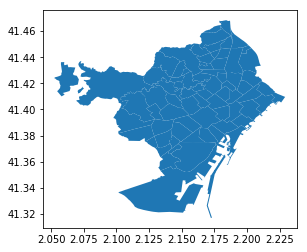

In [3]:
Boundary.plot()

## 2.2.  Barcelona AirBnB Listings
This is the dataset I prepared in section 1

In [6]:
import urllib
import geojson

In [7]:
# Read geojson file from github gist
# Listings of barcelona updated by March 2019
listing_url = "https://gist.githubusercontent.com/LiZhuang214/04d46aa0a30d5cf55f582568a2b37606/raw/76cd51ff34639ee4af5c37d0b0800e4e320bac04/AirBnB_Prepared.geojson"
listing = gpd.read_file(listing_url)
listing.head(5)

,FIELD1,id,name,host_id,host_name,neighbourhood_group,neighbourhood,room_type,price,minimum_nights,...,last_review,reviews_per_month,calculated_host_listings_count,availability_365,listing_url,summary,cancellation_policy,listing_ID,polarity,geometry
0,0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Sant Martí,el Camp de l'Arpa del Clot,Entire home/apt,130,3,...,2015-10-10,0.02,29,58,https://www.airbnb.com/rooms/18666,"Apartment located near the ""Plaza de las Glori...",flexible,18666,0.359583,POINT (2.18555 41.40889)
1,1,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia And Maria,Eixample,la Sagrada Família,Entire home/apt,60,1,...,2019-02-04,0.09,29,285,https://www.airbnb.com/rooms/18674,110m2 apartment to rent in Barcelona. Located ...,strict_14_with_grace_period,18674,0.244701,POINT (2.17306 41.4042)
2,2,23197,FORUM DELUXE 5 MINS WALK CCIB CENTER & SEA!,90417,Etain,Sant Martí,el Besòs i el Maresme,Entire home/apt,200,3,...,2019-01-01,0.36,2,310,https://www.airbnb.com/rooms/23197,"Beautiful apartment, large terrace, 5 min walk...",strict_14_with_grace_period,23197,0.330686,POINT (2.22114 41.41203)
3,3,25786,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,108310,Pedro,Gràcia,la Vila de Gràcia,Private room,36,1,...,2018-11-07,2.15,1,100,https://www.airbnb.com/rooms/25786,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,strict_14_with_grace_period,25786,0.387251,POINT (2.15645 41.40145)
4,4,31377,"Room for 2, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,42,3,...,2018-03-12,0.09,3,180,https://www.airbnb.com/rooms/31377,The room in 500 m from Sagrada Familia. 3 bran...,strict_14_with_grace_period,31377,0.116667,POINT (2.1707 41.41097)


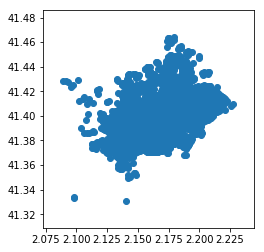

In [633]:
listing.plot()

## 2.3. API Barcelona Attractions and Restaurants
The data is obtained from api: http://tour-pedia.org/api/index.html with query

In [8]:
import sys
if sys.version_info[0] == 3:
    from urllib.request import urlopen
else:
    # Not Python 3 - today, it is most likely to be Python 2
    # But note that this might need an update when Python 4
    # might be around one day
    from urllib import urlopen


# Your code where you can use urlopen
with urlopen("http://www.python.org") as url:
    s = url.read()
print(s)

b'<!doctype html>\n<!--[if lt IE 7]>   <html class="no-js ie6 lt-ie7 lt-ie8 lt-ie9">   <![endif]-->\n<!--[if IE 7]>      <html class="no-js ie7 lt-ie8 lt-ie9">          <![endif]-->\n<!--[if IE 8]>      <html class="no-js ie8 lt-ie9">                 <![endif]-->\n<!--[if gt IE 8]><!--><html class="no-js" lang="en" dir="ltr">  <!--<![endif]-->\n\n<head>\n    <meta charset="utf-8">\n    <meta http-equiv="X-UA-Compatible" content="IE=edge">\n\n    <link rel="prefetch" href="//ajax.googleapis.com/ajax/libs/jquery/1.8.2/jquery.min.js">\n\n    <meta name="application-name" content="Python.org">\n    <meta name="msapplication-tooltip" content="The official home of the Python Programming Language">\n    <meta name="apple-mobile-web-app-title" content="Python.org">\n    <meta name="apple-mobile-web-app-capable" content="yes">\n    <meta name="apple-mobile-web-app-status-bar-style" content="black">\n\n    <meta name="viewport" content="width=device-width, initial-scale=1.0">\n    <meta name="Ha

In [9]:
# Load api from tour pedia and convert json to pandas dataframe
api_url = 'http://tour-pedia.org/api/getPlaces?location=Barcelona&category=attraction'
json_url = urlopen(api_url)

In [10]:
data = geojson.loads(json_url.read())
data = pd.DataFrame(data) 
type(data)

pandas.core.frame.DataFrame

In [11]:
# Convert pandas dataframe to geodataframe
from geopandas import GeoDataFrame
from shapely.geometry import Point

geometry = [Point(xy) for xy in zip(data.lng, data.lat)]
data = data.drop(['lng', 'lat'], axis=1)
crs = {'init': 'epsg:4326'}
gdf_POI = GeoDataFrame(data, crs=crs, geometry=geometry)

In [12]:
gdf_POI

,address,category,details,id,location,name,numReviews,originalId,polarity,reviews,subCategory,geometry
0,"Carrer de Marià Cubí, 182, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217950,Barcelona,Universal,2.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.144182 41.395081)
1,"C/ Diputació, 17, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217959,Barcelona,Centre Esportiu Joan Miró,1.0,NaN,0.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.151681 41.37904)
2,"Carrer de Pau Claris, 92, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217973,Barcelona,Monk Barcelona,5.0,NaN,7.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.170548 41.390273)
3,"Carrer Dels Escudellers, 5, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217977,Barcelona,New York,NaN,NaN,NaN,NaN,NaN,POINT (2.175923 41.37916)
4,"Carrer de Balmes, 32, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129545,Barcelona,Arena Madre,14.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.163971 41.388421)
5,"Carrer Nou de la Rambla, 3-5, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129563,Barcelona,Güell Palace,32.0,NaN,6.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.17424 41.378885)
6,"Carrer de ca l'Alegre de Dalt, 55, Barcelona, ...",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129560,Barcelona,KGB,16.0,NaN,6.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.160975 41.409181)
7,"Carrer dels Almogàvers, 122, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129561,Barcelona,Razzmatazz,16.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.191077 41.397732)
8,"Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129569,Barcelona,Plaça de Sant Agustí,1.0,NaN,0.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.171791 41.380674)
9,"Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129593,Barcelona,Jardins del Mirador,4.0,NaN,8.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.168885 41.367106)


In [279]:
### check out the category and subcategory contains in the dataset
print(gdf_POI.category.unique())
print(gdf_POI.subCategory.unique())

['attraction']
[nan 'Hotel' 'Cocktail Bar' 'Nightclub' 'Bar' 'Performing Arts Venue'
 'Speakeasy' 'Rock Club' 'Music Venue' 'Church' 'Spiritual Center'
 'Neighborhood' 'Monument / Landmark' 'Mountain' 'Plaza' 'Theme Park'
 'Ski Chairlift' 'Harbor / Marina' 'Basketball Stadium' 'Park' 'Multiplex'
 'Opera House' 'Theater' 'Concert Hall' 'Historic Site' 'Stadium'
 'Other Great Outdoors' 'Pool' 'Sports Bar' 'Pub' 'Sushi Restaurant'
 'Art Museum' 'Cemetery' 'Mediterranean Restaurant' 'Soccer Stadium'
 'Playground' 'Strip Club' 'Tapas Restaurant' 'Bowling Alley'
 'General Entertainment' 'Lounge' 'Café' 'Beer Garden'
 'Spanish Restaurant' 'Jazz Club' 'Sculpture Garden' 'Hostel'
 'Gym / Fitness Center' 'Soccer Field' 'Miscellaneous Shop' 'Museum'
 'Scenic Lookout' 'Brewery' 'Hotel Bar' 'Casino' 'Pizza Place' 'Trail'
 'General College & University' 'Baseball Field' 'Tennis' 'Arcade'
 'Event Space' 'Gym' 'Athletics & Sports' 'Comedy Club' 'Garden'
 'Indie Movie Theater' 'Tennis Court' 'City' 'Mo

Here I selected below types of tourists attractions to trim down the size of the dataset.

In [13]:
attractions = ['Performing Arts Venue','Church','Spiritual Center'
               ,'Monument / Landmark','Mountain','Plaza', 'Theme Park'
              ,'Harbor / Marina', 'Park', 'Multiplex','Opera House'
               , 'Theater', 'Concert Hall', 'Historic Site', 'Other Great Outdoors'
               ,'Art Museum', 'Cemetery', 'Sculpture Garden','Museum', 'Scenic Lookout'
               ,'Casino','Trail','Garden','City', 'Lake','Auditorium','Temple'
               ,'History Museum', 'Mosque', 'Science Museum', 'Bridge'
               ,'Nightlife Spot', 'Outdoors & Recreation', 'Arts & Entertainment'
               , 'Planetarium', 'Shrine','Farm', 'Water Park', 'Art Gallery'
              , 'Beach','Volcano' ,'Ski Area', 'Hot Spring','Surf Spot','Aquarium'
               ,'Public Art', 'Theme Park Ride / Attraction','Castle','Zoo']
print(attractions)

['Performing Arts Venue', 'Church', 'Spiritual Center', 'Monument / Landmark', 'Mountain', 'Plaza', 'Theme Park', 'Harbor / Marina', 'Park', 'Multiplex', 'Opera House', 'Theater', 'Concert Hall', 'Historic Site', 'Other Great Outdoors', 'Art Museum', 'Cemetery', 'Sculpture Garden', 'Museum', 'Scenic Lookout', 'Casino', 'Trail', 'Garden', 'City', 'Lake', 'Auditorium', 'Temple', 'History Museum', 'Mosque', 'Science Museum', 'Bridge', 'Nightlife Spot', 'Outdoors & Recreation', 'Arts & Entertainment', 'Planetarium', 'Shrine', 'Farm', 'Water Park', 'Art Gallery', 'Beach', 'Volcano', 'Ski Area', 'Hot Spring', 'Surf Spot', 'Aquarium', 'Public Art', 'Theme Park Ride / Attraction', 'Castle', 'Zoo']


In [14]:
## trim the dataset - contains only selected subcategories
gdf_POI = gdf_POI.loc[gdf_POI['subCategory'].isin(attractions)|gdf_POI['subCategory'].isnull()]

In [15]:
## Check the results
gdf_POI.loc[gdf_POI['subCategory']=='Monument / Landmark']
gdf_POI.loc[gdf_POI['subCategory']=='Church']
gdf_POI.loc[gdf_POI['subCategory']=='Historic Site']
gdf_POI.loc[gdf_POI['subCategory']=='History Museum']
gdf_POI.loc[gdf_POI['subCategory'].isnull()]

,address,category,details,id,location,name,numReviews,originalId,polarity,reviews,subCategory,geometry
0,"Carrer de Marià Cubí, 182, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217950,Barcelona,Universal,2.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.144182 41.395081)
1,"C/ Diputació, 17, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217959,Barcelona,Centre Esportiu Joan Miró,1.0,NaN,0.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.151681 41.37904)
2,"Carrer de Pau Claris, 92, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217973,Barcelona,Monk Barcelona,5.0,NaN,7.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.170548 41.390273)
3,"Carrer Dels Escudellers, 5, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=2...,217977,Barcelona,New York,NaN,NaN,NaN,NaN,NaN,POINT (2.175923 41.37916)
4,"Carrer de Balmes, 32, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129545,Barcelona,Arena Madre,14.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.163971 41.388421)
5,"Carrer Nou de la Rambla, 3-5, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129563,Barcelona,Güell Palace,32.0,NaN,6.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.17424 41.378885)
6,"Carrer de ca l'Alegre de Dalt, 55, Barcelona, ...",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129560,Barcelona,KGB,16.0,NaN,6.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.160975 41.409181)
7,"Carrer dels Almogàvers, 122, Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129561,Barcelona,Razzmatazz,16.0,NaN,5.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.191077 41.397732)
8,"Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129569,Barcelona,Plaça de Sant Agustí,1.0,NaN,0.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.171791 41.380674)
9,"Barcelona, Spain",attraction,http://tour-pedia.org/api/getPlaceDetails?id=1...,129593,Barcelona,Jardins del Mirador,4.0,NaN,8.0,http://tour-pedia.org/api/getReviewsByPlaceId?...,NaN,POINT (2.168885 41.367106)


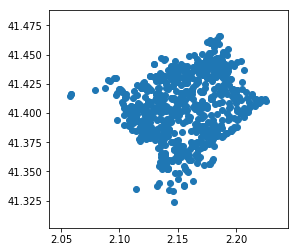

In [258]:
gdf_POI.plot()

## 2.4. Barcelona restaurants API
Similar to section 2.3, restaurant data can be obtained from the same api with different query. 

In [16]:
# Load api from tour pedia and convert json to pandas dataframe
api_url2 = 'http://tour-pedia.org/api/getPlaces?location=Barcelona&category=restaurant'
json_url2 = urlopen(api_url2)

In [17]:
data2 = geojson.loads(json_url2.read())
data2 = pd.DataFrame(data2) 
type(data2)

pandas.core.frame.DataFrame

In [18]:
# Convert pandas dataframe to geodataframe
from geopandas import GeoDataFrame
from shapely.geometry import Point

geometry2 = [Point(xy) for xy in zip(data2.lng, data2.lat)]
data2 = data2.drop(['lng', 'lat'], axis=1)
crs = {'init': 'epsg:4326'}
gdf_food = GeoDataFrame(data2, crs=crs, geometry=geometry2)
print(gdf_food.category.unique())

['restaurant']


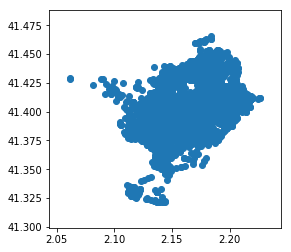

In [128]:
gdf_food.plot()

# 3. Conduct Spatial Cluster Analysis - DBSCAN
With the prepared dataset, cluster analysis can be done to further understand the pattern and cluster of listings based on the value and spatial features.

In [19]:
from sklearn.cluster import dbscan
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

First convert projection to epsg:3857

## 3.1. Load the data

In [20]:
listing_webm = listing.to_crs({'init': 'epsg:3857'})
print(listing_webm.crs)  # check projection
print(listing_webm.head(5))  # check data
print(listing_webm.columns)  # check columns - variables in dataset

{'init': 'epsg:3857'}
   FIELD1     id                                             name  host_id  \
0       0  18666                          Flat with Sunny Terrace    71615   
1       1  18674  Huge flat for 8 people close to Sagrada Familia    71615   
2       2  23197     FORUM DELUXE 5 MINS WALK  CCIB CENTER & SEA!    90417   
3       3  25786       NICE ROOM AVAILABLE IN THE HEART OF GRACIA   108310   
4       4  31377                      Room for 2,  Sagrada Famili   134698   

          host_name neighbourhood_group               neighbourhood  \
0  Mireia And Maria          Sant Martí  el Camp de l'Arpa del Clot   
1  Mireia And Maria            Eixample          la Sagrada Família   
2             Etain          Sant Martí       el Besòs i el Maresme   
3             Pedro              Gràcia           la Vila de Gràcia   
4          Svetlana      Horta-Guinardó            el Baix Guinardó   

         room_type  price  minimum_nights  ...  last_review reviews_per_month  \
0

In [22]:
listing_webm

,FIELD1,id,name,host_id,host_name,neighbourhood_group,neighbourhood,room_type,price,minimum_nights,...,last_review,reviews_per_month,calculated_host_listings_count,availability_365,listing_url,summary,cancellation_policy,listing_ID,polarity,geometry
0,0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Sant Martí,el Camp de l'Arpa del Clot,Entire home/apt,130,3,...,2015-10-10,0.02,29,58,https://www.airbnb.com/rooms/18666,"Apartment located near the ""Plaza de las Glori...",flexible,18666,0.359583,POINT (243294.3131032394 5072841.213324862)
1,1,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia And Maria,Eixample,la Sagrada Família,Entire home/apt,60,1,...,2019-02-04,0.09,29,285,https://www.airbnb.com/rooms/18674,110m2 apartment to rent in Barcelona. Located ...,strict_14_with_grace_period,18674,0.244701,POINT (241903.9326632317 5072145.128410277)
2,2,23197,FORUM DELUXE 5 MINS WALK CCIB CENTER & SEA!,90417,Etain,Sant Martí,el Besòs i el Maresme,Entire home/apt,200,3,...,2019-01-01,0.36,2,310,https://www.airbnb.com/rooms/23197,"Beautiful apartment, large terrace, 5 min walk...",strict_14_with_grace_period,23197,0.330686,POINT (247256.1737805709 5073307.276937391)
3,3,25786,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,108310,Pedro,Gràcia,la Vila de Gràcia,Private room,36,1,...,2018-11-07,2.15,1,100,https://www.airbnb.com/rooms/25786,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,strict_14_with_grace_period,25786,0.387251,POINT (240054.915921155 5071736.999640936)
4,4,31377,"Room for 2, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,42,3,...,2018-03-12,0.09,3,180,https://www.airbnb.com/rooms/31377,The room in 500 m from Sagrada Familia. 3 bran...,strict_14_with_grace_period,31377,0.116667,POINT (241641.2186649603 5073149.940842485)
5,5,31380,"Room for 2-3. Barcelona, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,53,3,...,2018-12-29,0.86,3,177,https://www.airbnb.com/rooms/31380,"Room for 2-3. Great location, right next to S...",strict_14_with_grace_period,31380,0.213511,POINT (241654.5770038545 5073139.550813374)
6,6,31958,"Gaudi Attic 1, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,62,1,...,2019-02-12,1.57,42,208,https://www.airbnb.com/rooms/31958,"This apartment has: 1 double bed, 1 double sof...",strict_14_with_grace_period,31958,0.360848,POINT (240381.0820291801 5072931.752582152)
7,7,32471,"Gaudi Attic 2, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,72,1,...,2019-01-17,0.68,42,210,https://www.airbnb.com/rooms/32471,"This apartment has: 2 double beds, 1 single be...",strict_14_with_grace_period,32471,0.351748,POINT (240574.7779431587 5072899.098981514)
8,8,32711,Sagrada Familia area - Còrsega 1,135703,Nick,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,140,2,...,2018-10-27,0.51,13,296,https://www.airbnb.com/rooms/32711,A lovely two bedroom apartment only 250 m from...,flexible,32711,0.266517,POINT (241512.0880556394 5072210.430616217)
9,9,34981,VIDRE HOME PLAZA REAL on LAS RAMBLAS,73163,Andres,Ciutat Vella,el Barri Gòtic,Entire home/apt,290,5,...,2019-02-03,1.27,1,182,https://www.airbnb.com/rooms/34981,Spacious apartment for large families or group...,strict_14_with_grace_period,34981,0.362944,POINT (242375.9273041948 5068345.004747307)


## 3.2. Extract and normalize several features

In [21]:
feature_columns = ['x', 'y', 'price', 
                   'polarity']

features = listing_webm[feature_columns]

KeyError: "['y', 'x'] not in index"

## 3.3. Run DBSCAN to extract high-density clusters

In [699]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/sklearn/base.py:464: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


In [754]:
# run DBSCAN 
cores, labels = dbscan(scaled_features, eps=0.35, min_samples=20)
features['label'] = labels

/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [789]:
# extract the number of clusters 
num_clusters = features['label'].nunique() - 1
print(num_clusters)

7


In [794]:
N = features.groupby('label').size()
# sort from largest to smallest
N = N.sort_values(ascending=False)
print(N)

label
 0    8583
-1    4592
 2     454
 1      87
 5      20
 4      18
 3      16
 6       9
dtype: int64


In [822]:
# extract labels (ignoring label -1 for noise)
top = list(N.iloc[0:6].index)
top.remove(-1)
print(top)

[0, 2, 1, 5, 4]


## 3.4. Get mean statistics for clusters and eliminate noise

In [823]:
# get the features for the top labels
selection = features['label'].isin(top)

# select top and groupby by the label
grps = features.loc[selection].groupby('label')

# calculate average price and polarity per cluster
avg_values = grps[['price', 'polarity']].mean()

avg_values

,price,polarity
label,,
0,69.891530,0.302038
1,35.356322,0.241928
2,55.770925,0.000793
4,65.166667,0.112980
5,55.200000,0.001071


## 3.5. Visualize the top largest clusters

plotting cluster #0...
plotting cluster #2...
plotting cluster #1...
plotting cluster #5...
plotting cluster #4...


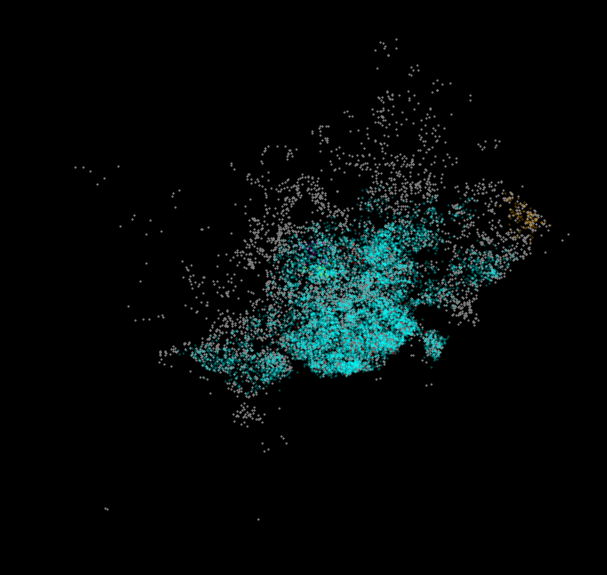

In [826]:
# Setup figure and axis
f, ax = plt.subplots(1, figsize=(10, 10), facecolor='black')

# Plot noise in grey
noise = features.loc[features['label']== -1]
ax.scatter(noise['x'], noise['y'], c='grey', s=5, linewidth=0)

# specify colors for each of the top 5 clusters
colors = ['aqua','red','orange','fuchsia','yellow']

# loop over top 5 largest clusters
for i, label_num in enumerate(top):
    print("plotting cluster #%d..." % label_num)
    
    # select all the samples with label equals "label_num"
    this_cluster = features.loc[features['label']==label_num]
    
    # plot pickups 
    ax.scatter(this_cluster['x'], this_cluster['y'], 
               linewidth=0, color=colors[i], s=5, alpha=0.3)
    
    # plot dropoffs
  #  ax.scatter(this_cluster['dropoff_x'], this_cluster['dropoff_y'], 
    #           linewidth=0, color=colors[i], s=5, alpha=0.3)
    
# Display the figure
ax.set_axis_off()
plt.show()

### Interactive Map

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
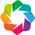

In [827]:
import datashader as ds
import holoviews as hv
import geoviews as gv
from holoviews.operation.datashader import datashade
hv.extension("bokeh")

In [828]:
# map colors to the top 5 cluster labels
color_key = dict(zip(top, ['aqua', 'red','orange','fuchsia', 'yellow']))
print(color_key)

{0: 'aqua', 2: 'red', 1: 'orange', 5: 'fuchsia', 4: 'yellow'}


In [829]:
# extract the features for the top 5 clusters
top_features = features.loc[features['label'].isin(top)]

# create Points for pickups and dropoffs
# kdims specifies column names for (x,y) coordinates
# vdims specific column name for categorical attribute
points = hv.Points(top_features, kdims=['x', 'y'], vdims=['label'])


# datashade, counting up the categorical "label" column
agg = datashade(points, color_key=color_key, aggregator=ds.count_cat('label'))

# set the background
bg = gv.tile_sources.CartoDark

# combine images
img = (bg * agg)
img.opts(width=800, height=600)

/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/holoviews/operation/datashader.py:324: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  df[category] = df[category].astype('category')


:DynamicMap   []
   :Overlay
      .WMTS.I :WMTS   [Longitude,Latitude]
      .RGB.I  :RGB   [x,y]   (R,G,B,A)

## 3.1.1. K-Means Cluster analysis - Non Spatial Features

In [40]:
print(listing['neighbourhood'].unique())
print(listing['neighbourhood_group'].unique())

listing['availability_365'] = listing['availability_365'].astype(float)
listing['price'] = listing['price'].astype(float)
listing['polarity'] = listing['polarity'].astype(float)


airbnb = (listing.groupby('neighbourhood', as_index=False)
       .agg({'availability_365':'mean', 'price':'mean', 'polarity':'mean','last_review':'size'})
       .rename(columns={'availability_365':'ave_availability_365', 'price':'ave_price','polarity':'ave_polarity','last_review':'count'}))
airbnb

["el Camp de l'Arpa del Clot" 'la Sagrada Família' 'el Besòs i el Maresme'
 'la Vila de Gràcia' 'el Baix Guinardó'
 "el Camp d'en Grassot i Gràcia Nova" 'el Barri Gòtic'
 "l'Antiga Esquerra de l'Eixample" 'la Barceloneta'
 "la Dreta de l'Eixample" 'Sant Pere, Santa Caterina i la Ribera'
 'el Fort Pienc' 'el Raval' 'Diagonal Mar i el Front Marítim del Poblenou'
 'Vallcarca i els Penitents' 'el Poblenou' 'el Poble Sec' 'el Clot'
 'Sant Antoni' 'Vallvidrera, el Tibidabo i les Planes' 'Sants' 'Pedralbes'
 'el Guinardó' 'les Corts' 'Provençals del Poblenou' 'Horta' 'Sant Andreu'
 'la Salut' 'Sants - Badal' 'Sant Gervasi - Galvany'
 'Sant Martí de Provençals' "la Nova Esquerra de l'Eixample" 'Sarrià'
 'el Coll' 'la Vila Olímpica del Poblenou' 'Hostafrancs'
 'el Parc i la Llacuna del Poblenou' 'la Font de la Guatlla'
 'el Putxet i el Farró' 'la Marina de Port' 'la Bordeta'
 'el Congrés i els Indians' 'Vilapicina i la Torre Llobeta' 'Torre Baró'
 'les Tres Torres' "la Font d'en Fargues" 'la Ma

,neighbourhood,ave_availability_365,ave_price,ave_polarity,count
0,Baró de Viver,202.500000,27.500000,0.361714,2
1,Can Baró,180.236842,53.500000,0.222185,38
2,Canyelles,268.750000,53.000000,0.202576,4
3,Ciutat Meridiana,208.555556,28.000000,0.205313,9
4,Diagonal Mar i el Front Marítim del Poblenou,206.539683,160.095238,0.293374,126
5,Horta,233.137931,41.034483,0.227742,29
6,Hostafrancs,176.509804,94.485294,0.265554,204
7,Montbau,198.400000,32.100000,0.207937,10
8,Navas,142.944444,33.814815,0.195362,54
9,Pedralbes,171.875000,80.812500,0.267494,16


In [41]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

kmeans = KMeans(n_clusters=5)

In [42]:
kmeans.fit(airbnb[['ave_price']])

airbnb['label'] = kmeans.labels_

In [43]:
airbnb.groupby('label').size()
scaler = StandardScaler()

airbnb.groupby('label').mean().sort_values('ave_price')
airbnb2 = pd.merge(Boundary, airbnb, left_on='neighbourhood', right_on='neighbourhood', how='inner')

In [315]:
# create an altair data source from a GeoJSON representation
data  = alt.InlineData(values=airbnb2.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))

# plot map, where variables ares nested within `properties`, 
Sentiment_alt = alt.Chart(data).mark_geoshape(
    stroke='white',
).properties(
    width=500,
    height=400,
    projection={"type":'mercator'},
).encode(
    tooltip=['properties.neighbourhood:N', 'properties.label:N'],
    color='properties.label:N'
)

In [316]:
Sentiment_alt.save("Sentiment_alt.json")
Sentiment_alt.save("Sentiment_alt.html")

# 4. Visualization

### 4.1. Marker Clusters/Points
4.1.1. Marker Clusters with pop-up to see each point properties - attractions 

4.1.2. Marker Clusters for listings (Not able to include pop-ups, maybe there are too many points, need javascript to achieve that)

### 4.2. Heatmaps  -  layers
4.2.1. Density of POI each neighborhood map (Heatmap)

4.2.2. Density of restaurants each neighborhood map (Heatmap)

4.2.3. Density of Listings Map in Barcelone

### 4.1 Choropleth Maps
4.3.1. Choropleth Map of the Density of Attractions - neighbourhood level

4.3.2. Choropleth Map of the density of Restaurants - neighbourhood level

4.3.3. Choropleth Map of the Density of AirBnB listings - neighbourhood level

## 4.0. Prepare Coordinate System

In [23]:
### prepare coordinate for place of interest
gdf_POI['latitude'] = gdf_POI.geometry.y
gdf_POI['longitude'] = gdf_POI.geometry.x
coordinates_POI = gdf_POI[['latitude', 'longitude']].values

/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/Users/lizhuang/anaconda3/envs/musa-620/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [24]:
### prepare coordinate for place of interest
gdf_food['latitude'] = gdf_food.geometry.y
gdf_food['longitude'] = gdf_food.geometry.x
coordinates_food = gdf_food[['latitude', 'longitude']].values

In [25]:
## Prepare coordinates for airbnb listings
listing['latitude'] = listing.geometry.y
listing['longitude'] = listing.geometry.x
coordinates_listing = listing[['latitude', 'longitude']].values

## 4.0.1. Define stypes and functions

In [82]:
folium.GeoJson?

In [121]:
folium.Map?

In [140]:
HeatMap?

In [296]:
folium.plugins.FastMarkerCluster?

In [26]:
# define plot style #00000000
def get_style_boundary(feature):
    return {'fillColor': '#00000000', 'weight': 2, 'color': 'white', 'opacity': 0.7}

In [27]:
## Specify Tooltip for neighbourhood boundary - show neighborhood name
tt = folium.GeoJsonTooltip(
     fields=['neighbourhood'],
     aliases=['Neighborhood:'],
     localize=True,
     style=('background-color: white; color: black; font-family:'
            'Arial; font-size: 12px; padding: 1px;')
 )

In [28]:
## define highlight style
highlight_function = lambda feature:  {
        "color":  'white',
        "weight":2,
        "fillColor": 'white',
        "fillOpacity": 0.6,
    }

## 4.0.1.1 Create html-css popup function for attractions points

In [29]:
gdf_POI['subCategory'].unique()
print(gdf_POI.columns)

Index(['address', 'category', 'details', 'id', 'location', 'name',
       'numReviews', 'originalId', 'polarity', 'reviews', 'subCategory',
       'geometry', 'latitude', 'longitude'],
      dtype='object')


### 1) Pop-up style for Barcelona Tourist attractions

In [30]:
def fancy_html(row):
    i = row
    
    Address = gdf_POI['address'].iloc[i]                             
    Name = gdf_POI['name'].iloc[i]                           
    Polarity = gdf_POI['polarity'].iloc[i]
    SubCategory = gdf_POI['subCategory'].iloc[i]                                           
    
    left_col_colour = "#1d1d1d"
    right_col_colour = "#e1e1e1"
    
    html = """<!DOCTYPE html>
<html opacity=0.5; >

<font size="3" face="Arial" opacity=0.8 >
<head>
<h5 style="margin-bottom:0"; width="250px">Attraction Detail</h5>""" + """

</head>
</font>

<font size="2" face="Arial" >
    <table style="height: 10px; width: 250px; opacity: 0.8">
<tbody>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Address</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(Address) + """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Name</span></td>
<td style="width: 250px; background-color: """+ right_col_colour +""";">{}</td>""".format(Name)+ """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Polarity</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(Polarity)+ """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">SubCategory</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(SubCategory)+ """
</tr>

</tbody>
</table>
</font>
</html>
"""
    return html

In [31]:
listing

,FIELD1,id,name,host_id,host_name,neighbourhood_group,neighbourhood,room_type,price,minimum_nights,...,calculated_host_listings_count,availability_365,listing_url,summary,cancellation_policy,listing_ID,polarity,geometry,latitude,longitude
0,0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Sant Martí,el Camp de l'Arpa del Clot,Entire home/apt,130,3,...,29,58,https://www.airbnb.com/rooms/18666,"Apartment located near the ""Plaza de las Glori...",flexible,18666,0.359583,POINT (2.18555 41.40889),41.40889,2.18555
1,1,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia And Maria,Eixample,la Sagrada Família,Entire home/apt,60,1,...,29,285,https://www.airbnb.com/rooms/18674,110m2 apartment to rent in Barcelona. Located ...,strict_14_with_grace_period,18674,0.244701,POINT (2.17306 41.4042),41.40420,2.17306
2,2,23197,FORUM DELUXE 5 MINS WALK CCIB CENTER & SEA!,90417,Etain,Sant Martí,el Besòs i el Maresme,Entire home/apt,200,3,...,2,310,https://www.airbnb.com/rooms/23197,"Beautiful apartment, large terrace, 5 min walk...",strict_14_with_grace_period,23197,0.330686,POINT (2.22114 41.41203),41.41203,2.22114
3,3,25786,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,108310,Pedro,Gràcia,la Vila de Gràcia,Private room,36,1,...,1,100,https://www.airbnb.com/rooms/25786,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,strict_14_with_grace_period,25786,0.387251,POINT (2.15645 41.40145),41.40145,2.15645
4,4,31377,"Room for 2, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,42,3,...,3,180,https://www.airbnb.com/rooms/31377,The room in 500 m from Sagrada Familia. 3 bran...,strict_14_with_grace_period,31377,0.116667,POINT (2.1707 41.41097),41.41097,2.17070
5,5,31380,"Room for 2-3. Barcelona, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,53,3,...,3,177,https://www.airbnb.com/rooms/31380,"Room for 2-3. Great location, right next to S...",strict_14_with_grace_period,31380,0.213511,POINT (2.17082 41.4109),41.41090,2.17082
6,6,31958,"Gaudi Attic 1, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,62,1,...,42,208,https://www.airbnb.com/rooms/31958,"This apartment has: 1 double bed, 1 double sof...",strict_14_with_grace_period,31958,0.360848,POINT (2.15938 41.4095),41.40950,2.15938
7,7,32471,"Gaudi Attic 2, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,72,1,...,42,210,https://www.airbnb.com/rooms/32471,"This apartment has: 2 double beds, 1 single be...",strict_14_with_grace_period,32471,0.351748,POINT (2.16112 41.40928),41.40928,2.16112
8,8,32711,Sagrada Familia area - Còrsega 1,135703,Nick,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,140,2,...,13,296,https://www.airbnb.com/rooms/32711,A lovely two bedroom apartment only 250 m from...,flexible,32711,0.266517,POINT (2.16954 41.40464),41.40464,2.16954
9,9,34981,VIDRE HOME PLAZA REAL on LAS RAMBLAS,73163,Andres,Ciutat Vella,el Barri Gòtic,Entire home/apt,290,5,...,1,182,https://www.airbnb.com/rooms/34981,Spacious apartment for large families or group...,strict_14_with_grace_period,34981,0.362944,POINT (2.1773 41.37859),41.37859,2.17730


In [495]:
branca.element.IFrame?

### 2) Pop-up Stype for AirBnB listings (P.S. Below pop-up cannot function correctly due to too many points I assume)

In [545]:
MarkerCluster?

In [308]:
def fancy_html2(row):
    i = row
    
    Name = listing['name'].iloc[i]    
    Neighbourhood = listing['neighbourhood'].iloc[i]                                                    
    Host_name = listing['host_name'].iloc[i]
    Room_type = listing['room_type'].iloc[i]                                           
    Price = listing['price'].iloc[i]  
    Minimum_nights = listing['minimum_nights'].iloc[i]  
    Availability_365 = listing['availability_365'].iloc[i]  
    
    
    left_col_colour = "#7d0174"
    right_col_colour = "#f9c8f7"
    
    
    html = """<!DOCTYPE html>
<html opacity=0.5; >

<font size="3" face="Arial" opacity=0.8 >
<head>
<h5 style="margin-bottom:0"; width="250px">AirBnB Detail</h5>""" + """

</head>
</font>

<font size="2" face="Arial" >
    <table style="height: 10px; width: 250px; opacity: 0.8">
<tbody>


<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Neighbourhood</span></td>
<td style="width: 250px; background-color: """+ right_col_colour +""";">{}</td>""".format(Neighbourhood)+ """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Room_type</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(Room_type)+ """
</tr>
<tr>
<td style="background-color: """+ left_col_colour +""";"><span style="color: #ffffff;">Price</span></td>
<td style="width: 250px;background-color: """+ right_col_colour +""";">{}</td>""".format(Price)+ """
</tr>

</tbody>
</table>
</font>
</html>
"""
    return html

__** Note: It is difficult to change css style of the default marker cluster in leaflet package in python. If time allows, I would change the cluster color to be the same for each type (listings, attractions) to avoid confusion instead of using the default shape and color using css.__

In [309]:
import branca
from folium.features import CustomIcon
from folium.plugins import MarkerCluster
# initialize map
m = folium.Map(
    location=[41.400432, 2.168336],
    #tiles='OpenStreetMap',
    tiles='cartodbdark_matter',
   # tiles='Cartodb Positron',
    zoom_start= 12
)

# add the GeoJson to the map usa boundary
folium.GeoJson(
    Boundary,
    name='Barcelona Neighborhood Boundary',
    style_function= get_style_boundary,
    control= False,
    overlay = False,
    show=True,
    tooltip = tt,
    highlight_function = highlight_function
).add_to(m)


mc = MarkerCluster(name = "Tourist Attractions", show = False).add_to(m)
mclisting = MarkerCluster(name = "Airbnb").add_to(m)

#Each location in the DataFrame is then added as a marker to the basemap points are then added to the map
for i in range(0,len(gdf_POI)):
    category = gdf_POI['subCategory'].iloc[i]
    if category == ['Museum','Art Museum','History Museum','Science Museum']:
        color = 'blue'
    elif category == 'Church':
        color = 'green'
    else:
        color = 'red'
        
        
    html = fancy_html(i)
 
    iframe = branca.element.IFrame(html=html,width=240,height=130)
    popup = folium.Popup(iframe,parse_html=True, max_width='75%')
    
    folium.Marker([gdf_POI['latitude'].iloc[i],gdf_POI['longitude'].iloc[i]]
    ,popup=popup,icon=folium.Icon(color=color, icon='camera')).add_to(mc)



#Each location in the DataFrame is then added as a marker to the basemap points are then added to the map
for i in range(0,len(listing)):
    
    html2 = fancy_html2(i)
 
    iframe2 = branca.element.IFrame(html=html2,width=240,height=130)
    popup2 = folium.Popup(iframe2,parse_html=True, max_width='75%')
    
    folium.Marker([listing['latitude'].iloc[i],listing['longitude'].iloc[i]]
    ,icon=folium.Icon(color="pink", icon='home')).add_to(mclisting)

#    folium.Marker([listing['latitude'].iloc[i],listing['longitude'].iloc[i]]).add_to(mclisting)


# add control layer
folium.LayerControl(collapsed=False).add_to(m)


# avoid a rendering bug by saving as HTML and re-loading
m.save('trymap.html')
## load previous map
IFrame('trymap.html', width=800, height=500)

__You can turn on and off different layers to explore the map. For Tourist attraction layer, you can list on the camera icon, and detail information about this place will popup. I fail to achieve this feature for airbnb listing data, ideally, the icon should be able to click and view detail information.__

In [490]:
folium.Popup?

## Heatmap and Marker Combined

In [305]:
from folium.features import CustomIcon
from folium.plugins import MarkerCluster
callback = """\
function (row) {
    var icon, marker;
    icon = L.AwesomeMarkers.icon({
        icon: "home", markerColor: "pink"});
    marker = L.marker(new L.LatLng(row[0], row[1]));
    marker.setIcon(icon);
    return marker;
};
"""
# initialize map
m = folium.Map(
    location=[41.400432, 2.168336],
    #tiles='OpenStreetMap',
    tiles='cartodbdark_matter',
   # tiles='Cartodb Positron',
    zoom_start= 12
)

# add the GeoJson to the map usa boundary
folium.GeoJson(
    Boundary,
    name='Barcelona Neighborhood Boundary',
    style_function= get_style_boundary,
    control= False,
    overlay = False,
    show=True,
    tooltip = tt,
    highlight_function = highlight_function
).add_to(m)

# add heat map
HeatMap(coordinates_listing, name = "AirBnB Listings Density", min_opacity=0.4, radius=13, blur=10, gradient=None, show=False).add_to(m)
# add heat map
HeatMap(coordinates_POI, name = "Barcelona Attractions Density", min_opacity=0.4, radius=13, blur=10, gradient=None, show = False).add_to(m)
# add heat map
HeatMap(coordinates_food, name = "Barcelona Restaurants Density", min_opacity=0.4, radius=13, blur=10, gradient=None, show = False).add_to(m)


mc = MarkerCluster(name = "Tourist Attractions", show = False).add_to(m)
#Each location in the DataFrame is then added as a marker to the basemap points are then added to the map
for i in range(0,len(gdf_POI)):
    category = gdf_POI['subCategory'].iloc[i]
    if category == ['Museum','Art Museum','History Museum','Science Museum']:
        color = 'blue'
    elif category == 'Church':
        color = 'green'
    else:
        color = 'red'
        
        
    html = fancy_html(i)
 
    iframe = branca.element.IFrame(html=html,width=240,height=130)
    popup = folium.Popup(iframe,parse_html=True, max_width='75%')
    
    folium.Marker([gdf_POI['latitude'].iloc[i],gdf_POI['longitude'].iloc[i]]
    ,popup=popup,icon=folium.Icon(color=color, icon='camera')).add_to(mc)


### Airbnb markers
marker_cluster = MarkerCluster(
    name='AirBnB Listings in Barcelona',
    overlay=True,
    control=True,
    icon_create_function=None
)

folium.plugins.FastMarkerCluster(
    data=coordinates_listing,
    name='AirBnB Listings in Barcelona',
    callback=callback
).add_to(m)



# add control layer
folium.LayerControl(collapsed=False).add_to(m)

m

In [306]:
# avoid a rendering bug by saving as HTML and re-loading
m.save('Barcelona_heatmapstest.html')
## load previous map
#IFrame('Barcelona_heatmaps.html', width=800, height=500)

In [ ]:
folium.plugins.MarkerCluster?
folium.plugins.FastMarkerCluster?

__I explored the use of overlay heatmap and points. and thinking it would be better to have a choropleth map as the base map instead since the heatmap is a little bit overwhelming. Below is another tryout for using choropleth map instead of heatmap.__

## -- Try chloropleth base map here --

In [135]:
airbnb_chloro = (listing.groupby('neighbourhood', as_index=False)
       .agg({'availability_365':'mean', 'price':'mean', 'polarity':'mean','last_review':'size'})
       .rename(columns={'availability_365':'ave_availability_365', 'price':'ave_price','polarity':'ave_polarity','last_review':'count'}))
airbnb_chloro
airbnb_chloro['neighbourhood'] = airbnb_chloro['neighbourhood'].astype(str)

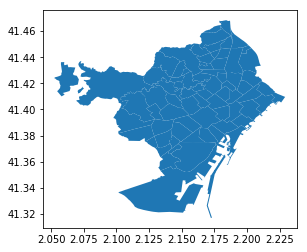

In [100]:
Boundary2 = Boundary.drop(columns = "neighbourhood_group")
Boundary2.plot()

In [104]:
temp1 = list(Boundary2['neighbourhood'].unique())
temp2 = list(airbnb_chloro['neighbourhood'].unique())

In [163]:
airbnb_chloroplot = pd.merge(Boundary2, airbnb_chloro, left_on='neighbourhood', right_on='neighbourhood', how='inner')

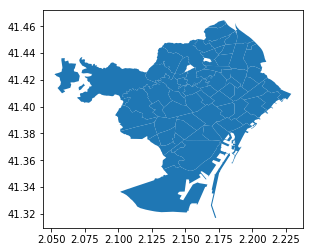

In [164]:
airbnb_chloroplot.plot()

In [112]:
temp2 = list(airbnb_chloroplot['neighbourhood'].unique())

In [113]:
list(set(temp1) - set(temp2))

[]

In [138]:
airbnb_chloroplot = airbnb_chloroplot.fillna(0)
airbnb_chloroplot

,neighbourhood,ave_availability_365,ave_price,ave_polarity,count,geometry
0,Baró de Viver,202.500000,27.500000,0.361714,2,"(POLYGON ((2.197061 41.442626, 2.195614 41.442..."
1,Can Baró,180.236842,53.500000,0.222185,38,"(POLYGON ((2.16617 41.420053, 2.166176 41.4200..."
2,Canyelles,268.750000,53.000000,0.202576,4,"(POLYGON ((2.162126 41.450235, 2.163739 41.449..."
3,Ciutat Meridiana,208.555556,28.000000,0.205313,9,"(POLYGON ((2.180267 41.461627, 2.180501 41.461..."
4,Diagonal Mar i el Front Marítim del Poblenou,206.539683,160.095238,0.293374,126,"(POLYGON ((2.213445 41.410672, 2.214146 41.410..."
5,Horta,233.137931,41.034483,0.227742,29,"(POLYGON ((2.159451 41.449661, 2.159436 41.449..."
6,Hostafrancs,176.509804,94.485294,0.265554,204,"(POLYGON ((2.145292 41.378576, 2.14579 41.3781..."
7,Montbau,198.400000,32.100000,0.207937,10,"(POLYGON ((2.136292 41.44277, 2.136314 41.4427..."
8,Navas,142.944444,33.814815,0.195362,54,"(POLYGON ((2.189009 41.418829, 2.19126 41.4171..."
9,Pedralbes,171.875000,80.812500,0.267494,16,"(POLYGON ((2.102776 41.401117, 2.102857 41.401..."


In [122]:
folium.Choropleth?

In [175]:
needed_cols = ['neighbourhood', 'ave_price', 'ave_polarity', 'count','geometry']
airbnbplot_json = airbnb_chloroplot[needed_cols]

In [224]:
alt.Chart?
alt.data_transformers.enable('default', max_rows=None)

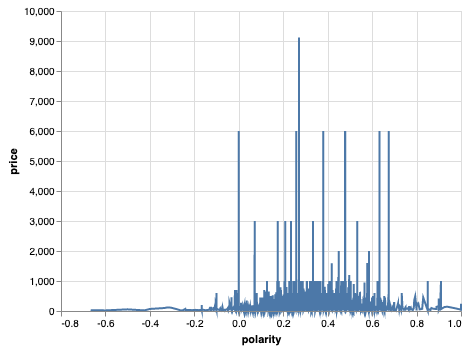

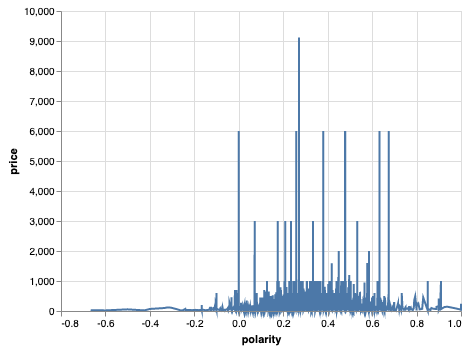

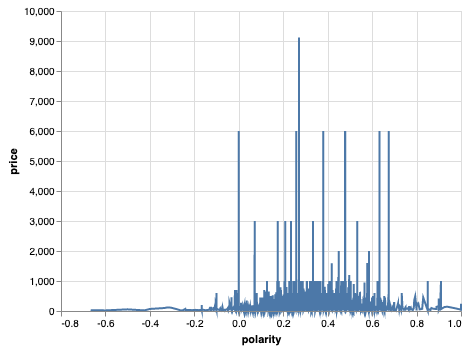

In [228]:
(alt.Chart(listing.drop(columns="geometry"))
.mark_line()
.encode(y='price', 
        x='polarity', 
        tooltip=['neighbourhood', 'price','polarity']))

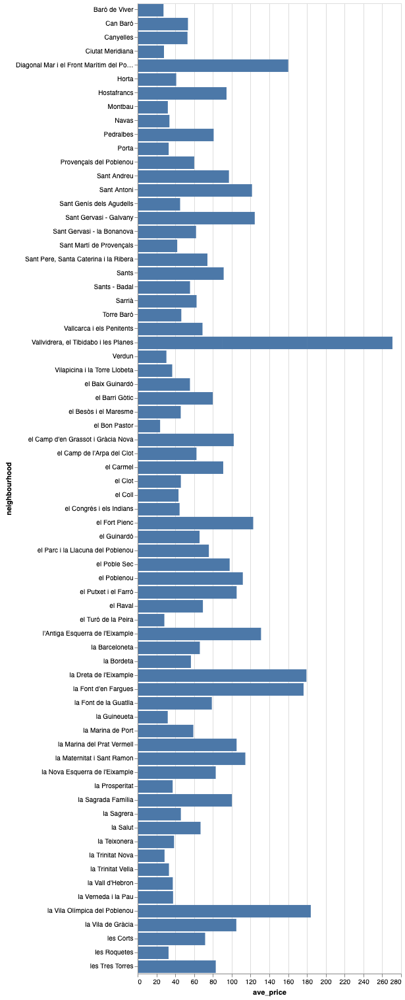

In [302]:
alt_chart = (alt.Chart(airbnbplot_json.drop(columns="geometry"))
.mark_bar()
.encode(y='neighbourhood', 
        x='ave_price', 
        tooltip=['neighbourhood', 'ave_price','ave_polarity','count']))
alt_chart

In [314]:
alt_chart.save("alt_chart.json")

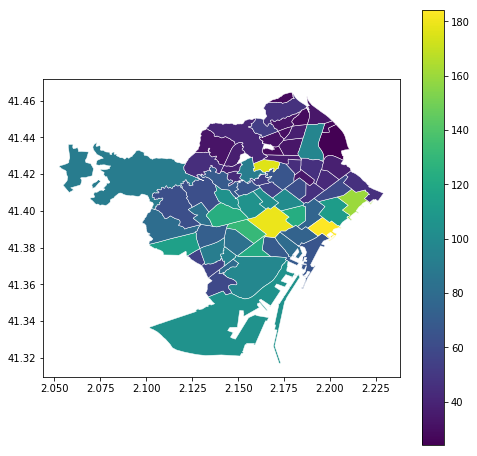

In [174]:
ax = airbnbplot_json.plot(column='ave_price', 
                   edgecolor='white',  linewidth=0.5, legend=True)
ax.figure.set_size_inches((8,8))

In [196]:
choro_json = json.loads(airbnbplot_json.to_json())
choro_data = alt.Data(values=choro_json['features'])

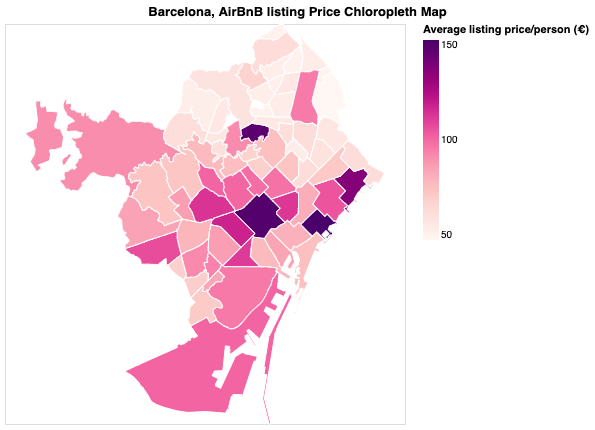

In [288]:
def gen_map(geodata, color_column, title):
    '''Generates chloropleth map with labels'''
    # Add Base Layer
    base = alt.Chart(geodata, title = title).mark_geoshape(
        stroke='white',
        strokeWidth=1
    ).encode(
    ).properties(
        width=400,
        height=400
    )
    # Add Choropleth Layer
    choro = alt.Chart(geodata).mark_geoshape(fill='lightgray',
        stroke='white'
    ).properties(
        width=700,
        height=400).encode(
    tooltip=[alt.Tooltip('properties.neighbourhood:N', title='Neighbourhood'), 
             alt.Tooltip('properties.ave_price:Q',title="Average listing price/person (€)",
                        format="d"), 
             alt.Tooltip('properties.ave_polarity:Q', title='Overall Satisfaction',format=".2"),
             alt.Tooltip('properties.count:Q', title='Number of Listings',format="d"),
            ],
    color=alt.Color(color_column, 
                    type='quantitative', 
                    title="Average listing price/person (€)", 
                    scale=alt.Scale(scheme='redpurple'))
)
    
        
    # Add Labels Layer
    labels = alt.Chart(geodata).mark_text(baseline='top'
     ).properties(
        width=400,
        height=400
     ).encode(
         longitude='properties.centroid_lon:Q',
         latitude='properties.centroid_lat:Q',
         size=alt.value(8),
         opacity=alt.value(1)
     )

    return base + choro + labels

listing_price = gen_map(geodata=choro_data, color_column='properties.ave_price', title='Barcelona, AirBnB listing Price Chloropleth Map')
listing_price


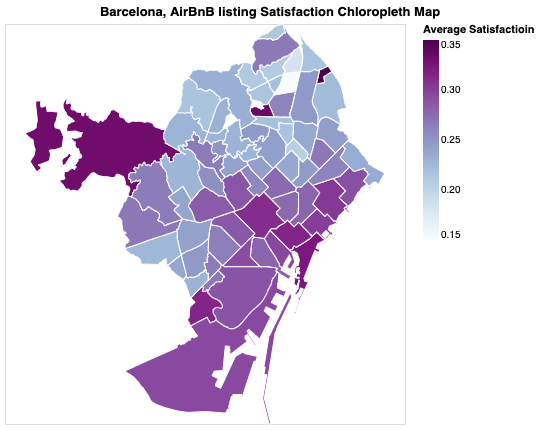

In [291]:
def gen_map(geodata, color_column, title):
    '''Generates chloropleth map with labels'''
    # Add Base Layer
    base = alt.Chart(geodata, title = title).mark_geoshape(
        stroke='white',
        strokeWidth=1
    ).encode(
    ).properties(
        width=400,
        height=400
    )
    # Add Choropleth Layer
    choro = alt.Chart(geodata).mark_geoshape(fill='lightgray',
        stroke='white'
    ).properties(
        width=700,
        height=400).encode(
    tooltip=[alt.Tooltip('properties.neighbourhood:N', title='Neighbourhood'), 
             alt.Tooltip('properties.ave_price:Q',title="Average listing price/person (€)",
                        format="d"), 
             alt.Tooltip('properties.ave_polarity:Q', title='Overall Satisfaction',format=".2"),
             alt.Tooltip('properties.count:Q', title='Number of Listings',format="d"),
            ],
    color=alt.Color(color_column, 
                    type='quantitative', 
                    title="Average Satisfactioin", 
                    scale=alt.Scale(scheme='bluepurple'))
)
    
        
    # Add Labels Layer
    labels = alt.Chart(geodata).mark_text(baseline='top'
     ).properties(
        width=400,
        height=400
     ).encode(
         longitude='properties.centroid_lon:Q',
         latitude='properties.centroid_lat:Q',
         size=alt.value(8),
         opacity=alt.value(1)
     )

    return base + choro + labels



listing_polarity = gen_map(geodata=choro_data, color_column='properties.ave_polarity', title='Barcelona, AirBnB listing Satisfaction Chloropleth Map')
listing_polarity

In [290]:
alt.Scale?

In [313]:
listing_polarity.save("listing_polarity.json")
listing_price.save("listing_price.json")

In [204]:
alt.Tooltip?

## Layers of Maps
__Plot listing Price range Map - dasher__

__Plot average listing price in neighbourhood__

__average single room listing price__

__average share room listing price__

__average entire home listing price__

## -- Bar plots -- Scatter plots here --
1. neighbouthood price - average
2. cancellation and price
3. room type and price

4. overall satisfaction and price -- scatterplot
5. density of restaurants and price -- scatterplot
6. density of attractions and price -- scatterplot

In [865]:
import IPython 
print(IPython.__version__)
print(alt.renderers.active)
print(alt.__version__)

7.1.1
notebook
2.4.1


In [874]:
alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

In [227]:
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

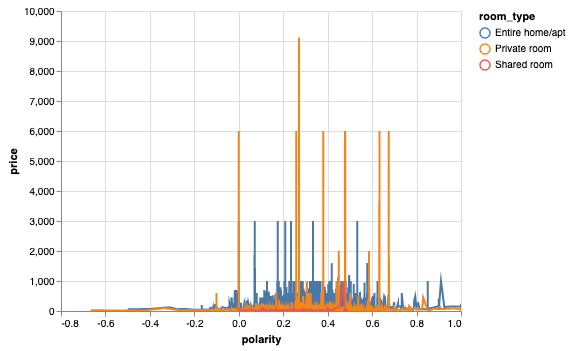

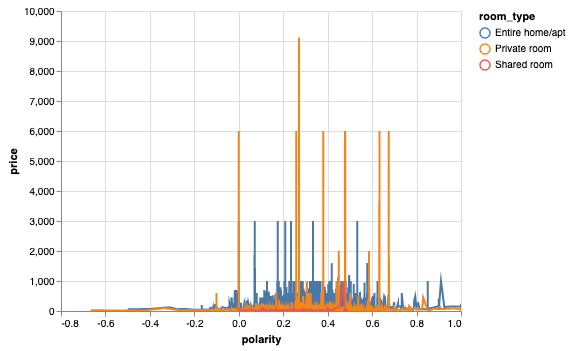

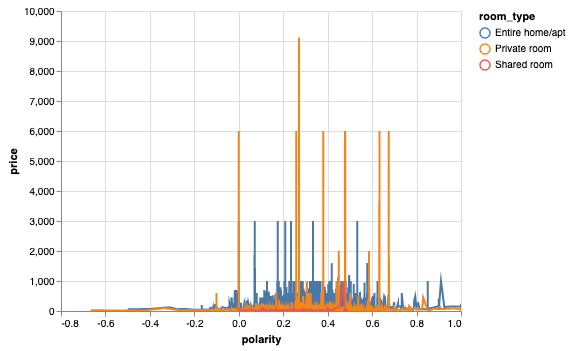

In [230]:
# interactive scatter plot of price (x-axis) vs. size (y-axis), with the points colored by the number of bedrooms.
chart = alt.Chart(listing.drop(columns="geometry"))

# define what kind of marks to use
chart = chart.mark_line(size=1)

# encode the visual channels
chart = chart.encode(
    x='polarity', 
    y='price',
    color='room_type',
    tooltip=['name', "price", "polarity","room_type"]
)

# make the chart interactive
chart.interactive()

In [238]:
import hvplot.pandas
import holoviews as hv

In [249]:
listing

,FIELD1,id,name,host_id,host_name,neighbourhood_group,neighbourhood,room_type,price,minimum_nights,...,calculated_host_listings_count,availability_365,listing_url,summary,cancellation_policy,listing_ID,polarity,geometry,latitude,longitude
0,0,18666,Flat with Sunny Terrace,71615,Mireia And Maria,Sant Martí,el Camp de l'Arpa del Clot,Entire home/apt,130.0,3,...,29,58.0,https://www.airbnb.com/rooms/18666,"Apartment located near the ""Plaza de las Glori...",flexible,18666,0.359583,POINT (2.18555 41.40889),41.40889,2.18555
1,1,18674,Huge flat for 8 people close to Sagrada Familia,71615,Mireia And Maria,Eixample,la Sagrada Família,Entire home/apt,60.0,1,...,29,285.0,https://www.airbnb.com/rooms/18674,110m2 apartment to rent in Barcelona. Located ...,strict_14_with_grace_period,18674,0.244701,POINT (2.17306 41.4042),41.40420,2.17306
2,2,23197,FORUM DELUXE 5 MINS WALK CCIB CENTER & SEA!,90417,Etain,Sant Martí,el Besòs i el Maresme,Entire home/apt,200.0,3,...,2,310.0,https://www.airbnb.com/rooms/23197,"Beautiful apartment, large terrace, 5 min walk...",strict_14_with_grace_period,23197,0.330686,POINT (2.22114 41.41203),41.41203,2.22114
3,3,25786,NICE ROOM AVAILABLE IN THE HEART OF GRACIA,108310,Pedro,Gràcia,la Vila de Gràcia,Private room,36.0,1,...,1,100.0,https://www.airbnb.com/rooms/25786,JUST GO THROUGH THE MANY REVIEWS I GOT THROUGH...,strict_14_with_grace_period,25786,0.387251,POINT (2.15645 41.40145),41.40145,2.15645
4,4,31377,"Room for 2, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,42.0,3,...,3,180.0,https://www.airbnb.com/rooms/31377,The room in 500 m from Sagrada Familia. 3 bran...,strict_14_with_grace_period,31377,0.116667,POINT (2.1707 41.41097),41.41097,2.17070
5,5,31380,"Room for 2-3. Barcelona, Sagrada Famili",134698,Svetlana,Horta-Guinardó,el Baix Guinardó,Private room,53.0,3,...,3,177.0,https://www.airbnb.com/rooms/31380,"Room for 2-3. Great location, right next to S...",strict_14_with_grace_period,31380,0.213511,POINT (2.17082 41.4109),41.41090,2.17082
6,6,31958,"Gaudi Attic 1, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,62.0,1,...,42,208.0,https://www.airbnb.com/rooms/31958,"This apartment has: 1 double bed, 1 double sof...",strict_14_with_grace_period,31958,0.360848,POINT (2.15938 41.4095),41.40950,2.15938
7,7,32471,"Gaudi Attic 2, Friendly Rentals",136853,Fidelio,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,72.0,1,...,42,210.0,https://www.airbnb.com/rooms/32471,"This apartment has: 2 double beds, 1 single be...",strict_14_with_grace_period,32471,0.351748,POINT (2.16112 41.40928),41.40928,2.16112
8,8,32711,Sagrada Familia area - Còrsega 1,135703,Nick,Gràcia,el Camp d'en Grassot i Gràcia Nova,Entire home/apt,140.0,2,...,13,296.0,https://www.airbnb.com/rooms/32711,A lovely two bedroom apartment only 250 m from...,flexible,32711,0.266517,POINT (2.16954 41.40464),41.40464,2.16954
9,9,34981,VIDRE HOME PLAZA REAL on LAS RAMBLAS,73163,Andres,Ciutat Vella,el Barri Gòtic,Entire home/apt,290.0,5,...,1,182.0,https://www.airbnb.com/rooms/34981,Spacious apartment for large families or group...,strict_14_with_grace_period,34981,0.362944,POINT (2.1773 41.37859),41.37859,2.17730


In [298]:
temp = listing.drop(columns="geometry")

hv_heatmap = (temp.hvplot.heatmap(x='room_type', y='neighbourhood', C='price', reduce_function=np.mean, colorbar=True, height = 700, title="Price/person/night in €")+
 temp.hvplot.heatmap(x='room_type', y='neighbourhood', C='polarity', reduce_function=np.mean, colorbar=True, height = 700, title="Overall Satisfaction - 1: Satisfy; -1: Not Satisfy")+
 temp.hvplot.heatmap(x='cancellation_policy', y='neighbourhood', C='polarity', reduce_function=np.mean, colorbar=True,height = 700, title="Overall Satisfaction - 1: Satisfy; -1: Not Satisfy").opts(xrotation=45)
 )
hv_heatmap

:Layout
   .HeatMap.I   :HeatMap   [room_type,neighbourhood]   (price)
   .HeatMap.II  :HeatMap   [room_type,neighbourhood]   (polarity)
   .HeatMap.III :HeatMap   [cancellation_policy,neighbourhood]   (polarity)

In [311]:
hvheatmap_1 = temp.hvplot.heatmap(x='room_type', y='neighbourhood', C='price', reduce_function=np.mean, colorbar=True, height = 700, title="Price/person/night in €")
hvheatmap_2 = temp.hvplot.heatmap(x='room_type', y='neighbourhood', C='polarity', reduce_function=np.mean, colorbar=True, height = 700, title="Overall Satisfaction - 1: Satisfy; -1: Not Satisfy")
hvheatmap_3 = temp.hvplot.heatmap(x='cancellation_policy', y='neighbourhood', C='polarity', reduce_function=np.mean, colorbar=True,height = 700, title="Overall Satisfaction - 1: Satisfy; -1: Not Satisfy").opts(xrotation=45)


In [312]:
hvplot.save(hvheatmap_1, 'hvheatmap_1.html')
hvplot.save(hvheatmap_2, 'hvheatmap_2.html')
hvplot.save(hvheatmap_3, 'hvheatmap_3.html')
hvplot.save(hv_heatmap, 'hv_heatmap.html')

In [253]:
temp.hvplot.scatter('price', 'polarity', datashade=True)

:DynamicMap   []
   :RGB   [price,polarity]   (R,G,B,A)